<a href="https://colab.research.google.com/github/DivyatejM/Algorithmic_Analysis_of_Social_Network/blob/main/Solar_Output_Prediction_(_DSM).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
##Importing all necessary packages

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import zipfile

# Plant Generation Data
df_gen = pd.read_csv('/content/Plant_2_Generation_Data.csv')

# Plant Weather Data
df_weather = pd.read_csv('/content/Plant_2_Weather_Sensor_Data.csv')

In [ ]:
df_gen.head()

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
0,2020-05-15 00:00:00,4136001,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06
1,2020-05-15 00:00:00,4136001,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09
2,2020-05-15 00:00:00,4136001,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09
3,2020-05-15 00:00:00,4136001,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06
4,2020-05-15 00:00:00,4136001,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07


In [ ]:
df_weather.head()

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4136001,iq8k7ZNt4Mwm3w0,27.004764,25.060789,0.0
1,2020-05-15 00:15:00,4136001,iq8k7ZNt4Mwm3w0,26.880811,24.421869,0.0
2,2020-05-15 00:30:00,4136001,iq8k7ZNt4Mwm3w0,26.682055,24.427290,0.0
3,2020-05-15 00:45:00,4136001,iq8k7ZNt4Mwm3w0,26.500589,24.420678,0.0
4,2020-05-15 01:00:00,4136001,iq8k7ZNt4Mwm3w0,26.596148,25.088210,0.0


In [ ]:
df_gen.describe()


,PLANT_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
count,67698.0,67698.000000,67698.000000,67698.000000,6.769800e+04
mean,4136001.0,246.701961,241.277825,3294.890295,6.589448e+08
std,0.0,370.569597,362.112118,2919.448386,7.296678e+08
min,4136001.0,0.000000,0.000000,0.000000,0.000000e+00
25%,4136001.0,0.000000,0.000000,272.750000,1.996494e+07
50%,4136001.0,0.000000,0.000000,2911.000000,2.826276e+08
75%,4136001.0,446.591667,438.215000,5534.000000,1.348495e+09
max,4136001.0,1420.933333,1385.420000,9873.000000,2.247916e+09


In [ ]:
df_weather.describe()

,PLANT_ID,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
count,3259.0,3259.000000,3259.000000,3259.000000
mean,4136001.0,28.069400,32.772408,0.232737
std,0.0,4.061556,11.344034,0.312693
min,4136001.0,20.942385,20.265123,0.000000
25%,4136001.0,24.602135,23.716881,0.000000
50%,4136001.0,26.981263,27.534606,0.019040
75%,4136001.0,31.056757,40.480653,0.438717
max,4136001.0,39.181638,66.635953,1.098766


In [ ]:
print('Plant ID ',df_gen.PLANT_ID.nunique())
print('No. of Inverters ',df_gen.SOURCE_KEY.nunique())
print('No. of Unique Source key',df_weather.SOURCE_KEY.nunique())
print('Null values in generation data: \n',df_gen.isnull().sum())
print('Null values in generation data: \n',df_weather.isnull().sum())

Plant ID  1
No. of Inverters  22
No. of Unique Source key 1
Null values in generation data: 
 DATE_TIME      0
PLANT_ID       0
SOURCE_KEY     0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64
Null values in generation data: 
 DATE_TIME              0
PLANT_ID               0
SOURCE_KEY             0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
dtype: int64


In [ ]:
#Dropping PLANT_ID 
df_gen.drop('PLANT_ID', axis=1, inplace=True)
df_weather.drop('PLANT_ID', axis = 1, inplace=True)

## Mapping
Inverter_labels = {inverter_no:inverter_name for inverter_name,inverter_no in enumerate(df_gen['SOURCE_KEY'].unique(),1)}
df_gen['Inverter_No'] = df_gen['SOURCE_KEY'].map(Inverter_labels) 

## Drop Source Key after replacing with inverter numbers
df_gen.drop('SOURCE_KEY',axis=1,inplace=True)
df_weather.drop('SOURCE_KEY',axis=1,inplace=True)

In [ ]:
df_gen_old = df_gen.copy()

In [ ]:
df_gen['Inverter_No'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22])

In [ ]:
df_gen = df_gen[['DATE_TIME','Inverter_No' ,'DC_POWER', 'AC_POWER','DAILY_YIELD','TOTAL_YIELD']]
df_gen.groupby('Inverter_No')[['DATE_TIME']].count()

,DATE_TIME
Inverter_No,
1,3195
2,3259
3,3259
4,3195
5,2355
6,3259
7,3259
8,3195
9,2355


In [ ]:
df_old_grouped_mean = df_gen.groupby('Inverter_No')[['DATE_TIME','DC_POWER','AC_POWER','DAILY_YIELD','TOTAL_YIELD']].agg(['mean']).reset_index(drop=True)
df_old_grouped_max = df_gen_old.groupby('Inverter_No')[['DATE_TIME','DC_POWER','AC_POWER','DAILY_YIELD','TOTAL_YIELD']].agg(['max']).reset_index(drop=True)

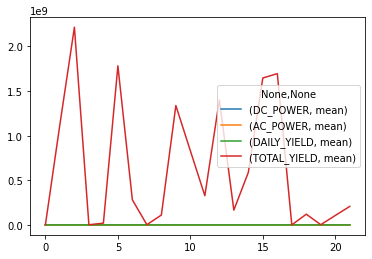

In [ ]:
df_old_grouped_mean.plot()

In [ ]:
df_old_grouped_max.index+1

RangeIndex(start=1, stop=23, step=1)

In [ ]:
a=list(df_gen['Inverter_No'].unique())

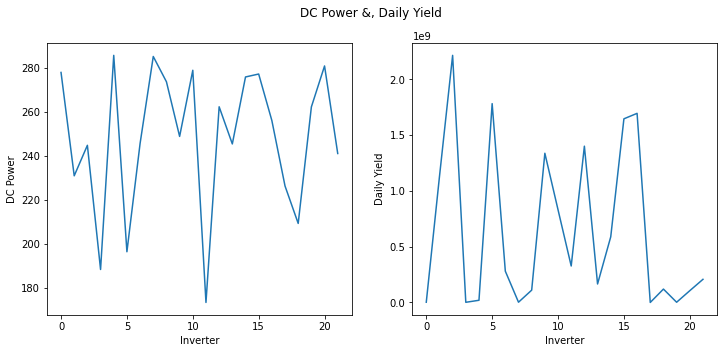

In [ ]:
f = plt.figure(figsize=(12,5))
ax1 = f.add_subplot(121)
ax2 = f.add_subplot(122)
f.suptitle('DC Power &, Daily Yield')
ax1.plot(df_old_grouped_mean['DC_POWER'])
ax2.plot(df_old_grouped_mean['TOTAL_YIELD'])
ax1.set_xlabel('Inverter')
ax1.set_ylabel('DC Power')

ax2.set_xlabel('Inverter')
ax2.set_ylabel('Daily Yield')
plt.show()

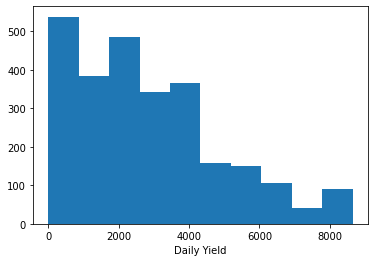

In [ ]:
plt.hist(df_gen[(df_gen['Inverter_No']==4)&(df_gen['DAILY_YIELD']!=0)]['DAILY_YIELD'])
plt.xlabel('Daily Yield')
plt.show()

In [ ]:
print('Inverter {} has data for {} timestamps(Minimum)'.
      format(df_gen.groupby('Inverter_No')['DATE_TIME'].count().argmin()+1,df_gen.groupby('Inverter_No')['DATE_TIME'].count().min()))
print('Inverter {} has data for {} timestamps(Maximum)'.
      format(df_gen.groupby('Inverter_No')['DATE_TIME'].count().argmax()+1,df_gen.groupby('Inverter_No')['DATE_TIME'].count().max()))     
print('DIFFERENCE = {}'.format(df_gen.groupby('Inverter_No')['DATE_TIME'].count().max() - 
                               df_gen.groupby('Inverter_No')['DATE_TIME'].count().min()))

Inverter 5 has data for 2355 timestamps(Minimum)
Inverter 2 has data for 3259 timestamps(Maximum)
DIFFERENCE = 904


In [ ]:
df_gen['Inverter_No'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22])

In [ ]:
df_gen.to_csv('df_gen.csv')

In [ ]:
df_gen_copy=df_gen.copy()

In [ ]:
df_gen.drop(['DAILY_YIELD','TOTAL_YIELD'], axis=1, inplace=True)

In [ ]:
from functools import reduce

grouped = df_gen.groupby('Inverter_No')

## Making a list of each Inverter group 
dfs = list()
for i in df_gen['Inverter_No'].unique():
    dfs.append(grouped.get_group(i))
  

 ## Merging data inverterwise using 'reduce'
 ## Applying merge function to all of the list elements of 'dfs' in the sequence passed.

df_new = reduce(lambda left,right: pd.merge(left,right,on=['DATE_TIME'],how='outer'),dfs)

display(df_new)

<ipython-input-91-781d171427e2>:14: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Inverter_No_x', 'DC_POWER_x', 'AC_POWER_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_new = reduce(lambda left,right: pd.merge(left,right,on=['DATE_TIME'],how='outer'),dfs)


,DATE_TIME,Inverter_No_x,DC_POWER_x,AC_POWER_x,Inverter_No_y,DC_POWER_y,AC_POWER_y,Inverter_No_x,DC_POWER_x,AC_POWER_x,...,AC_POWER_x,Inverter_No_y,DC_POWER_y,AC_POWER_y,Inverter_No_x,DC_POWER_x,AC_POWER_x,Inverter_No_y,DC_POWER_y,AC_POWER_y
0,2020-05-15 00:00:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
1,2020-05-15 00:15:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
2,2020-05-15 00:30:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
3,2020-05-15 00:45:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
4,2020-05-15 01:00:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
5,2020-05-15 01:15:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
6,2020-05-15 01:30:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
7,2020-05-15 01:45:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
8,2020-05-15 02:00:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
9,2020-05-15 02:15:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000


In [ ]:
df_new.columns = ['DATE_TIME',
        'DC_POWER_1', 'AC_POWER_1',
        'Inverter_No_1', 'DC_POWER_2', 'AC_POWER_2',
        'Inverter_No_2', 'DC_POWER_3', 'AC_POWER_3',
        'Inverter_No_3', 'DC_POWER_4', 'AC_POWER_4',
        'Inverter_No_4', 'DC_POWER_5', 'AC_POWER_5',
        'Inverter_No_5', 'DC_POWER_6', 'AC_POWER_6',
        'Inverter_No_6', 'DC_POWER_7', 'AC_POWER_7',
        'Inverter_No_7', 'DC_POWER_8', 'AC_POWER_8',
        'Inverter_No_8', 'DC_POWER_9', 'AC_POWER_9',
        'Inverter_No_9', 'DC_POWER_10', 'AC_POWER_10',
        'Inverter_No_10', 'DC_POWER_11', 'AC_POWER_11',
        'Inverter_No_11', 'DC_POWER_12', 'AC_POWER_12',
        'Inverter_No_12', 'DC_POWER_13', 'AC_POWER_13',
        'Inverter_No_13', 'DC_POWER_14', 'AC_POWER_14',
        'Inverter_No_14', 'DC_POWER_15', 'AC_POWER_15',
        'Inverter_No_15', 'DC_POWER_16', 'AC_POWER_16',
        'Inverter_No_16', 'DC_POWER_17', 'AC_POWER_17',
        'Inverter_No_17', 'DC_POWER_18', 'AC_POWER_18',
        'Inverter_No_18', 'DC_POWER_19', 'AC_POWER_19',
        'Inverter_No_19', 'DC_POWER_20', 'AC_POWER_20',
        'Inverter_No_20', 'DC_POWER_21', 'AC_POWER_21',
        'Inverter_No_21', 'DC_POWER_22', 'AC_POWER_22',
        'Inverter_No_22'
      ]

In [ ]:
display(df_new)

,DATE_TIME,DC_POWER_1,AC_POWER_1,Inverter_No_1,DC_POWER_2,AC_POWER_2,Inverter_No_2,DC_POWER_3,AC_POWER_3,Inverter_No_3,...,Inverter_No_19,DC_POWER_20,AC_POWER_20,Inverter_No_20,DC_POWER_21,AC_POWER_21,Inverter_No_21,DC_POWER_22,AC_POWER_22,Inverter_No_22
0,2020-05-15 00:00:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
1,2020-05-15 00:15:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
2,2020-05-15 00:30:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
3,2020-05-15 00:45:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
4,2020-05-15 01:00:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
5,2020-05-15 01:15:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
6,2020-05-15 01:30:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
7,2020-05-15 01:45:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
8,2020-05-15 02:00:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
9,2020-05-15 02:15:00,1.0,0.000000,0.000000,2,0.000000,0.000000,3,0.000000,0.000000,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000


In [ ]:
df_weather['DATE_TIME'] = df_weather['DATE_TIME'].astype(str)
df_new['DATE_TIME'] = df_new['DATE_TIME'].astype(str)

#Merging Generation & Weather datasets
df = df_weather.merge(df_new,left_on='DATE_TIME',right_on='DATE_TIME',how='outer')

#Generating 15 min time blocks
tb = pd.date_range('15-05-2020','16-05-2020',freq='15min')
tb=tb[:-1] 
ts = tb.strftime('%H:%M')
block_dict = {}
j=1
for i in range(len(ts)):
    block_dict[ts[i]] =  j
    j+=1

# Making new columns of Time,BLOCK and Date 
df['TIME'] = df['DATE_TIME'].apply(lambda x:str(x)[-8:-3])
df['DATE'] = pd.to_datetime(df['DATE_TIME']).dt.date
df['BLOCK'] = pd.to_datetime(df['TIME']).astype(str).apply(lambda x:block_dict[str(x)[-8:-3]])

#Droping DATE_TIME column
df.drop('DATE_TIME',axis=1,inplace=True)
np.save('timestamp_block_dictionary.npy',block_dict)

## Column re-ordering
cols = df.columns.tolist()
df = df[[cols[-1]]+[cols[-2]]+[cols[-3]]+cols[:-3]]

display(df)

,BLOCK,DATE,TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DC_POWER_1,AC_POWER_1,Inverter_No_1,DC_POWER_2,...,Inverter_No_19,DC_POWER_20,AC_POWER_20,Inverter_No_20,DC_POWER_21,AC_POWER_21,Inverter_No_21,DC_POWER_22,AC_POWER_22,Inverter_No_22
0,1,2020-05-15,00:00,27.004764,25.060789,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
1,2,2020-05-15,00:15,26.880811,24.421869,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
2,3,2020-05-15,00:30,26.682055,24.427290,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
3,4,2020-05-15,00:45,26.500589,24.420678,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
4,5,2020-05-15,01:00,26.596148,25.088210,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
5,6,2020-05-15,01:15,26.512740,25.317970,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
6,7,2020-05-15,01:30,26.494339,25.217193,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
7,8,2020-05-15,01:45,26.420410,25.065062,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
8,9,2020-05-15,02:00,26.401946,24.691469,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000
9,10,2020-05-15,02:15,26.226078,24.559481,0.000000,1.0,0.000000,0.000000,2,...,0.000000,20,0.000000,0.000000,21.0,0.000000,0.000000,22,0.000000,0.000000


In [ ]:

#Getting last 5 days data 
last_5_days = df['DATE'].astype(str).unique()[-5:]
df_test = df[df['DATE'].astype(str).isin(last_5_days)].sort_values(by=['DATE','BLOCK'])

#Saving Test data
df_test.reset_index(drop=True).to_csv('Test_data.csv')

#Saving all as Train for indexes not present in test data
df_train = df[~df.index.isin(df_test.index)]
df_train.to_csv('Train_data.csv')

## Checking shapes
print('Train:',df_train.shape)
print('Test:',df_test.shape)

## Check for missing values
print('No. of missing values in train dataset: ',list(df_train.isnull().sum()))

Train: (2779, 72)
Test: (480, 72)
No. of missing values in train dataset:  [0, 0, 0, 0, 0, 0, 64, 64, 64, 0, 0, 0, 0, 0, 0, 64, 64, 64, 904, 904, 904, 0, 0, 0, 0, 0, 0, 64, 64, 64, 904, 904, 904, 0, 0, 0, 64, 64, 64, 64, 64, 64, 0, 0, 0, 0, 0, 0, 904, 904, 904, 64, 64, 64, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 904, 904, 904, 0, 0, 0]


In [ ]:
[df_train.isnull().sum()]

[BLOCK                    0
 DATE                     0
 TIME                     0
 AMBIENT_TEMPERATURE      0
 MODULE_TEMPERATURE       0
 IRRADIATION              0
 DC_POWER_1              64
 AC_POWER_1              64
 Inverter_No_1           64
 DC_POWER_2               0
 AC_POWER_2               0
 Inverter_No_2            0
 DC_POWER_3               0
 AC_POWER_3               0
 Inverter_No_3            0
 DC_POWER_4              64
 AC_POWER_4              64
 Inverter_No_4           64
 DC_POWER_5             904
 AC_POWER_5             904
 Inverter_No_5          904
 DC_POWER_6               0
 AC_POWER_6               0
 Inverter_No_6            0
 DC_POWER_7               0
 AC_POWER_7               0
 Inverter_No_7            0
 DC_POWER_8              64
 AC_POWER_8              64
 Inverter_No_8           64
 DC_POWER_9             904
 AC_POWER_9             904
 Inverter_No_9          904
 DC_POWER_10              0
 AC_POWER_10              0
 Inverter_No_10     

In [ ]:
df_train['DATE'][96*3:96*4]

288    2020-05-18
289    2020-05-18
290    2020-05-18
291    2020-05-18
292    2020-05-18
293    2020-05-18
294    2020-05-18
295    2020-05-18
296    2020-05-18
297    2020-05-18
298    2020-05-18
299    2020-05-18
300    2020-05-18
301    2020-05-18
302    2020-05-18
303    2020-05-18
304    2020-05-18
305    2020-05-18
306    2020-05-18
307    2020-05-18
308    2020-05-18
309    2020-05-18
310    2020-05-18
311    2020-05-18
312    2020-05-18
313    2020-05-18
314    2020-05-18
315    2020-05-18
316    2020-05-18
317    2020-05-18
318    2020-05-18
319    2020-05-18
320    2020-05-18
321    2020-05-18
322    2020-05-18
323    2020-05-18
324    2020-05-18
325    2020-05-18
326    2020-05-18
327    2020-05-18
328    2020-05-18
329    2020-05-18
330    2020-05-18
331    2020-05-18
332    2020-05-18
333    2020-05-18
334    2020-05-18
335    2020-05-18
336    2020-05-18
337    2020-05-18
338    2020-05-18
339    2020-05-18
340    2020-05-18
341    2020-05-18
342    2020-05-18
343    202

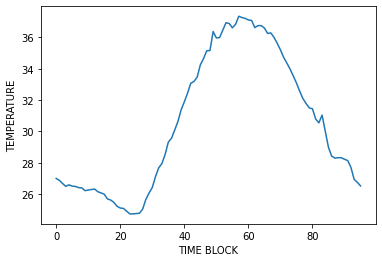

In [ ]:
df_train['AMBIENT_TEMPERATURE'][0:96].plot()
plt.xlabel('TIME BLOCK')
plt.ylabel('TEMPERATURE')
plt.show()

In [ ]:
print(list(df_train.isnull().sum()))

[0, 0, 0, 0, 0, 0, 0, 0]


In [ ]:
## Columns having non-zero values during day-time only
day_only_columns = []
subcolumns = ['DC_POWER','AC_POWER','IRRADIATION']
for column in df_train.columns:
    if any(x in column for x in subcolumns):
        day_only_columns.append(column)

In [ ]:
df_train.head()

,BLOCK,DATE,TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER,DC_POWER
0,1,2020-05-15,00:00,27.004764,25.060789,0.0,0.0,0.253
1,2,2020-05-15,00:15,26.880811,24.421869,0.0,0.0,0.253
2,3,2020-05-15,00:30,26.682055,24.427290,0.0,0.0,0.253
3,4,2020-05-15,00:45,26.500589,24.420678,0.0,0.0,0.253
4,5,2020-05-15,01:00,26.596148,25.088210,0.0,0.0,0.253


In [ ]:
day_only_columns=list()
DC_cols = [i for i in df.columns if 'DC_POWER' in i]
AC_cols = [i for i in df.columns if 'AC_POWER' in i]
day_only_columns = DC_cols+AC_cols+["IRRADIATION"]

Data prepared on the plant level now, i.e. all 22 inverter values have been summed up and scaled to MW from kW.

In [ ]:
def Data_Preparation_Plant_Level(df):
    for col in day_only_columns:
        df[col] = df[col].astype(float)
        # For time except for non-generating hours(12 am to 6 am & 6 pm to 12 am) will be replaced by zero
        df.loc[df[(~((df['BLOCK']>24) & (df['BLOCK']<73))) & df[col].isnull()].index,col] = 0

     
    #1.AC & DC columns
    df[DC_cols+AC_cols].interpolate(method='polynomial',order = 2,inplace=True)
    #2.Left NaN values in Irradiation, Ambient Temp, Module Temp, Inverter_No
    df.interpolate(method='linear',inplace=True)
    
    # Summing up Inverter wise AC and DC values to reach Plant-level generation
    df['AC_POWER'] = df.loc[: ,AC_cols].sum(axis=1)
    df['DC_POWER'] = df.loc[:,DC_cols].sum(axis=1)
    df['AC_POWER'] = df['AC_POWER']/1000
    df['DC_POWER'] = df['DC_POWER']/1000
    
    return df

In [ ]:
df_train.isnull().sum()

BLOCK                  0
DATE                   0
TIME                   0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
DC_POWER_1             0
AC_POWER_1             0
Inverter_No_1          0
DC_POWER_2             0
AC_POWER_2             0
Inverter_No_2          0
DC_POWER_3             0
AC_POWER_3             0
Inverter_No_3          0
DC_POWER_4             0
AC_POWER_4             0
Inverter_No_4          0
DC_POWER_5             0
AC_POWER_5             0
Inverter_No_5          0
DC_POWER_6             0
AC_POWER_6             0
Inverter_No_6          0
DC_POWER_7             0
AC_POWER_7             0
Inverter_No_7          0
DC_POWER_8             0
AC_POWER_8             0
Inverter_No_8          0
DC_POWER_9             0
AC_POWER_9             0
Inverter_No_9          0
DC_POWER_10            0
AC_POWER_10            0
Inverter_No_10         0
DC_POWER_11            0
AC_POWER_11            0
Inverter_No_11         0
DC_POWER_12            0


In [ ]:
df_test = Data_Preparation_Plant_Level(df_test)

In [ ]:
df_test = df_test[['BLOCK', 'DATE', 'TIME', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE','IRRADIATION','AC_POWER']]

In [ ]:
df_train.head()

,BLOCK,DATE,TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DC_POWER_1,AC_POWER_1,Inverter_No_1,DC_POWER_2,...,AC_POWER_20,Inverter_No_20,DC_POWER_21,AC_POWER_21,Inverter_No_21,DC_POWER_22,AC_POWER_22,Inverter_No_22,AC_POWER,DC_POWER
0,1,2020-05-15,00:00,27.004764,25.060789,0.0,1.0,0.0,0.0,2.0,...,0.0,0.0,21.0,0.0,0.0,22.0,0.0,0.0,0.0,0.253
1,2,2020-05-15,00:15,26.880811,24.421869,0.0,1.0,0.0,0.0,2.0,...,0.0,0.0,21.0,0.0,0.0,22.0,0.0,0.0,0.0,0.253
2,3,2020-05-15,00:30,26.682055,24.427290,0.0,1.0,0.0,0.0,2.0,...,0.0,0.0,21.0,0.0,0.0,22.0,0.0,0.0,0.0,0.253
3,4,2020-05-15,00:45,26.500589,24.420678,0.0,1.0,0.0,0.0,2.0,...,0.0,0.0,21.0,0.0,0.0,22.0,0.0,0.0,0.0,0.253
4,5,2020-05-15,01:00,26.596148,25.088210,0.0,1.0,0.0,0.0,2.0,...,0.0,0.0,21.0,0.0,0.0,22.0,0.0,0.0,0.0,0.253


In [ ]:
df_train = df_train[['BLOCK', 'DATE', 'TIME', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE','IRRADIATION','AC_POWER', 'DC_POWER']]

In [ ]:
df_train['AMBIENT_TEMPERATURE'] = df_train['AMBIENT_TEMPERATURE'].astype(float)
df_train['MODULE_TEMPERATURE'] = df_train['MODULE_TEMPERATURE'].astype(float)

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2779 entries, 0 to 2778
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   BLOCK                2779 non-null   int64  
 1   DATE                 2779 non-null   object 
 2   TIME                 2779 non-null   object 
 3   AMBIENT_TEMPERATURE  2779 non-null   float64
 4   MODULE_TEMPERATURE   2779 non-null   float64
 5   IRRADIATION          2779 non-null   float64
 6   AC_POWER             2779 non-null   float64
 7   DC_POWER             2779 non-null   float64
dtypes: float64(5), int64(1), object(2)
memory usage: 259.9+ KB


In [ ]:
df_train = df_train.loc[:,~df_train.columns.duplicated()]

In [ ]:
df_test

,BLOCK,DATE,TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER
2779,1,2020-06-13,00:00,23.184430,22.943785,0.000000,0.000000
2780,2,2020-06-13,00:15,23.150216,22.906561,0.000000,0.000000
2781,3,2020-06-13,00:30,23.112692,22.756978,0.000000,0.000000
2782,4,2020-06-13,00:45,23.082374,22.745495,0.000000,0.000000
2783,5,2020-06-13,01:00,23.006015,22.405011,0.000000,0.000000
2784,6,2020-06-13,01:15,22.890840,22.013978,0.000000,0.000000
2785,7,2020-06-13,01:30,22.820713,21.930839,0.000000,0.000000
2786,8,2020-06-13,01:45,22.720887,21.774492,0.000000,0.000000
2787,9,2020-06-13,02:00,22.555871,21.473888,0.000000,0.000000
2788,10,2020-06-13,02:15,22.479495,21.197295,0.000000,0.000000


In [ ]:
df_train.to_csv('df_train.csv')
df_test.to_csv('df_test.csv')

In [ ]:
df_train[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE','IRRADIATION','AC_POWER', 'DC_POWER']].corr()

,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER,DC_POWER
AMBIENT_TEMPERATURE,1.000000,0.839520,0.654535,0.645718,-0.168806
MODULE_TEMPERATURE,0.839520,1.000000,0.946881,0.884897,-0.095180
IRRADIATION,0.654535,0.946881,1.000000,0.924278,-0.053579
AC_POWER,0.645718,0.884897,0.924278,1.000000,0.033107
DC_POWER,-0.168806,-0.095180,-0.053579,0.033107,1.000000


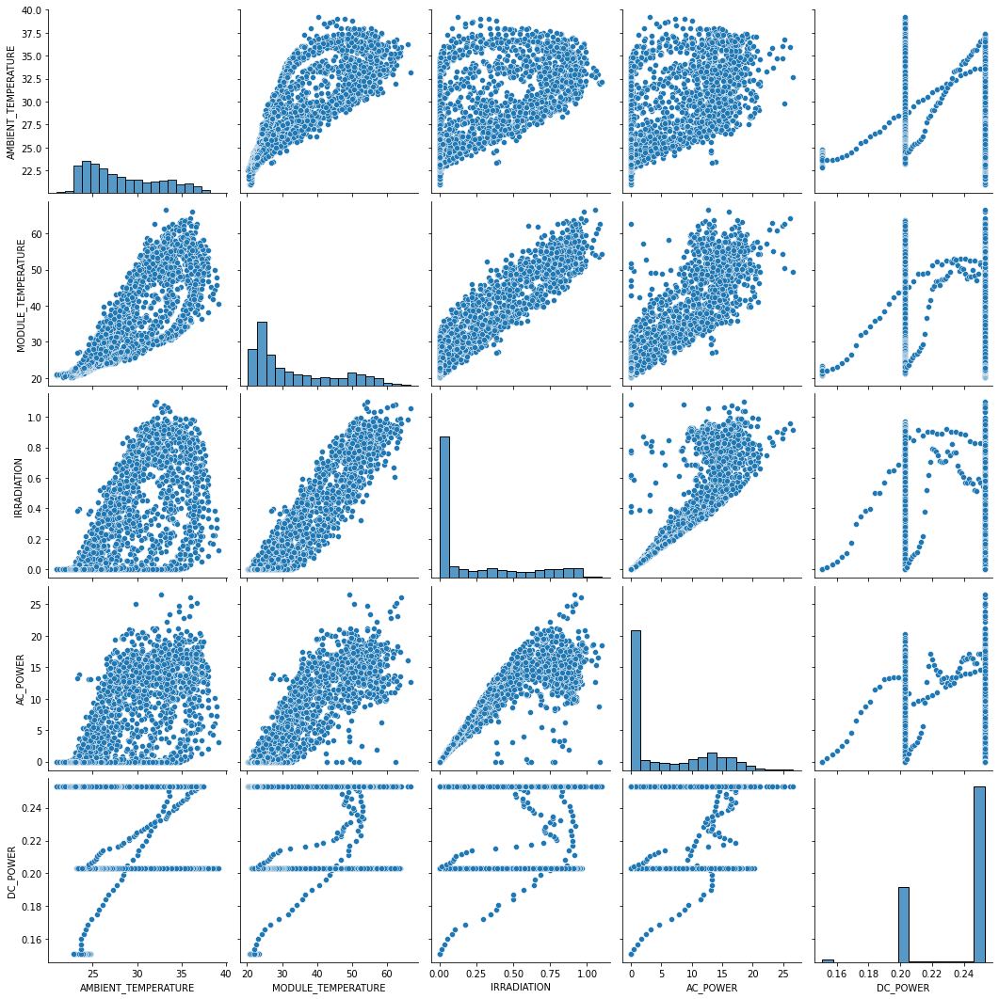

In [ ]:
sns.pairplot(df_train[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE', 'IRRADIATION','AC_POWER','DC_POWER']],height=3)

i.High variation in Module Temperature with each degree rise in Ambient temperature

ii.There are not much outliers

Text(0, 0.5, 'MODULE TEMPERATURE')

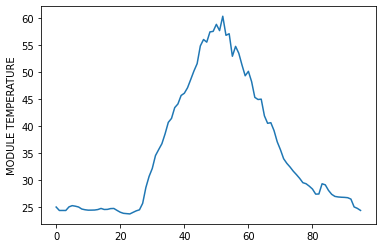

In [ ]:
plt.plot(df_train['MODULE_TEMPERATURE'][0:96])
plt.ylabel('MODULE TEMPERATURE')

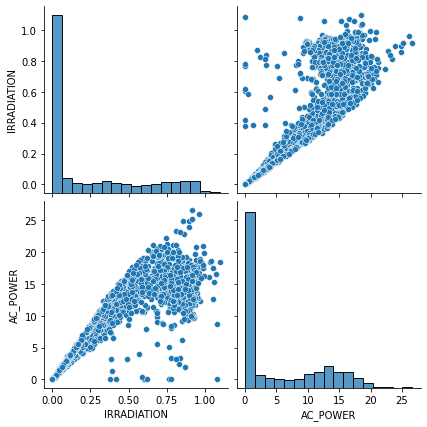

In [ ]:
sns.pairplot(df_train[['IRRADIATION','AC_POWER']],height=3)

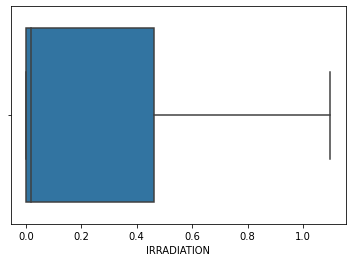

In [ ]:
sns.boxplot(data=df_train,x='IRRADIATION')

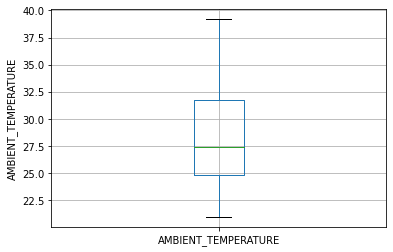

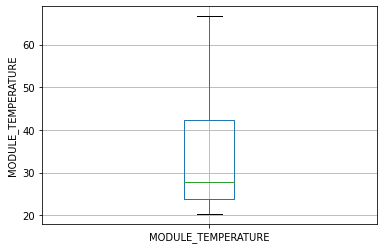

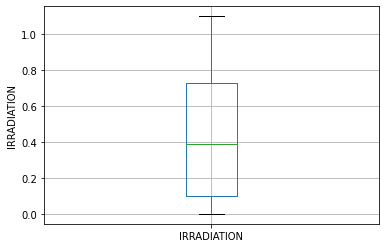

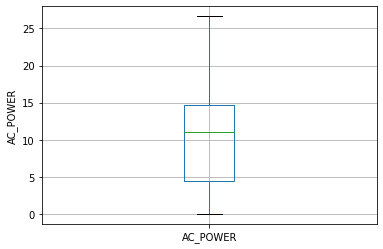

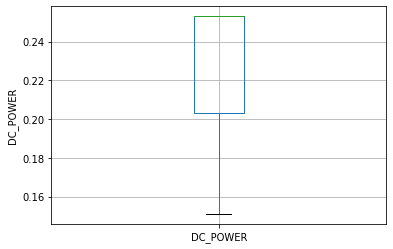

In [ ]:
for feature in df_train.columns[3:]:
    df_train[df_train[feature]!=0].boxplot(column=feature)
    plt.ylabel(feature)
    plt.show()

In [ ]:
pd.set_option('display.max_row', None)
df_train

,BLOCK,DATE,TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER,DC_POWER
0,1,2020-05-15,00:00,27.004764,25.060789,0.000000,0.000000,0.253000
1,2,2020-05-15,00:15,26.880811,24.421869,0.000000,0.000000,0.253000
2,3,2020-05-15,00:30,26.682055,24.427290,0.000000,0.000000,0.253000
3,4,2020-05-15,00:45,26.500589,24.420678,0.000000,0.000000,0.253000
4,5,2020-05-15,01:00,26.596148,25.088210,0.000000,0.000000,0.253000
5,6,2020-05-15,01:15,26.512740,25.317970,0.000000,0.000000,0.253000
6,7,2020-05-15,01:30,26.494339,25.217193,0.000000,0.000000,0.253000
7,8,2020-05-15,01:45,26.420410,25.065062,0.000000,0.000000,0.253000
8,9,2020-05-15,02:00,26.401946,24.691469,0.000000,0.000000,0.253000
9,10,2020-05-15,02:15,26.226078,24.559481,0.000000,0.000000,0.253000


In [ ]:
df_gen

,DATE_TIME,Inverter_No,DC_POWER,AC_POWER
0,2020-05-15 00:00:00,1,0.000000,0.000000
1,2020-05-15 00:00:00,2,0.000000,0.000000
2,2020-05-15 00:00:00,3,0.000000,0.000000
3,2020-05-15 00:00:00,4,0.000000,0.000000
4,2020-05-15 00:00:00,5,0.000000,0.000000
5,2020-05-15 00:00:00,6,0.000000,0.000000
6,2020-05-15 00:00:00,7,0.000000,0.000000
7,2020-05-15 00:00:00,8,0.000000,0.000000
8,2020-05-15 00:00:00,9,0.000000,0.000000
9,2020-05-15 00:00:00,10,0.000000,0.000000


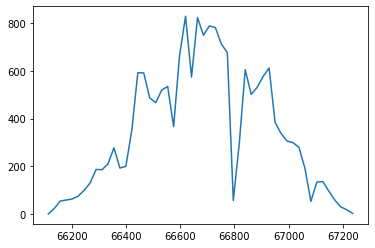

In [ ]:
df2 = df_gen.copy() ## Making a copy
df2['DATE'] = pd.to_datetime(df_gen['DATE_TIME']).dt.date.astype(str)
## Selecting a date and replacing AC Power with NaN wherever its 0 and plotting 
indexes = df2[(df2['Inverter_No']==1)&(df2['DATE']=='2020-06-17')&(df2['AC_POWER']==0)].index
df2.loc[indexes,'AC_POWER']=np.nan
df2 = df2[(df2['Inverter_No']==1)&(df2['DATE']=='2020-06-17')]['AC_POWER']
df2.plot();

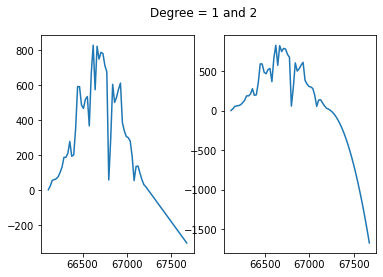

In [ ]:
## Comparison between 1 & 2 degree splines
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle('Degree = 1 and 2')
ax1.plot(df2.interpolate(method='spline',order=1))
ax2.plot(df2.interpolate(method='spline',order=2));

,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER,DC_POWER
AMBIENT_TEMPERATURE,1.000000,0.839520,0.654535,0.645718,-0.168806
MODULE_TEMPERATURE,0.839520,1.000000,0.946881,0.884897,-0.095180
IRRADIATION,0.654535,0.946881,1.000000,0.924278,-0.053579
AC_POWER,0.645718,0.884897,0.924278,1.000000,0.033107
DC_POWER,-0.168806,-0.095180,-0.053579,0.033107,1.000000


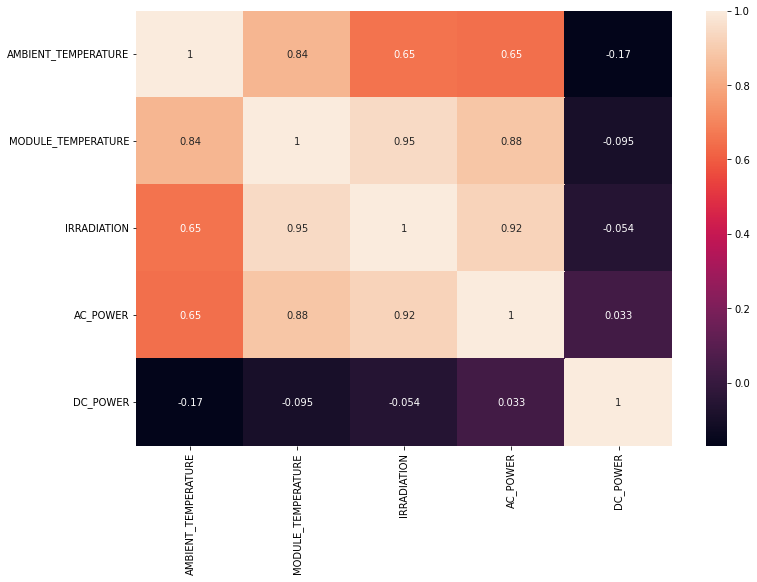

In [ ]:
display(df_train.iloc[:,1:].corr())
plt.figure(figsize = (12,8))
sns.heatmap(df_train[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE', 'IRRADIATION',
       'AC_POWER', 'DC_POWER']].corr(),annot=True)


In [ ]:
df_train.drop('DC_POWER',axis=1,inplace=True)
percentile_dict = {}
for i in df_train.columns[3:]:
    a_list = []
    for j in [1,10,25,50,75,90,99,100]:
        a_list.append(round(np.percentile(df_train[i],j),2))
    percentile_dict[i] = a_list    
pd.DataFrame(pd.concat([pd.DataFrame({'Percentiles':[1,10,25,50,75,90,99,100]}),pd.DataFrame(percentile_dict)],axis=1))        
    

,Percentiles,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER
0,1,22.76,21.11,0.00,0.00
1,10,23.67,22.42,0.00,0.00
2,25,24.85,23.83,0.00,0.00
3,50,27.37,27.81,0.02,0.45
4,75,31.75,42.26,0.46,11.61
5,90,34.83,52.56,0.81,15.75
6,99,37.41,60.47,0.97,20.05
7,100,39.18,66.64,1.10,26.63


In [ ]:
outlier_imputer_dict = {}

for var in df_train.columns[3:]:
    percentile_dict = {}
    
    NinetyNine_percentile = np.percentile(df_train[var],99)  
       
    First_percentile = np.percentile(df_train[var],1)

    percentile_dict['99th'] =  NinetyNine_percentile
    percentile_dict['1st'] =  First_percentile  
    # Saving as dictionary for each column
    outlier_imputer_dict[var] = percentile_dict
      
#Saving the final dictionary         
np.save('outlier_imputer_dict',outlier_imputer_dict)    
def outlier_imputer(df):
    #Loading Outlier Imputer dictionary
    outlier_dict = np.load('outlier_imputer_dict.npy',allow_pickle='TRUE').item()
    
    for var in df.columns[3:]:
        
        df.loc[df[df[var] > outlier_dict[var]['99th']].index,var] = outlier_dict[var]['99th']  
       
        df.loc[df[df[var] < outlier_dict[var]['1st']].index,var] = outlier_dict[var]['1st']
    
    return df

    print(outlier_imputer_dict)

#Applying imputation on Train & Test 
df_train = outlier_imputer(df_train)
df_test = outlier_imputer(df_test)

In [ ]:
#No. of bins
cut_blocks = [1,2,3,4,5,6,7,8]
#Bins range
cut_bins =[0, 12, 24, 36, 48, 60, 72, 84, 96]
#Assigning each row to a bin based on BLOCKS
df_train['BIN'] = pd.cut(df_train['BLOCK'], bins=cut_bins, labels = cut_blocks)
display(df_train)

,BLOCK,DATE,TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,AC_POWER,BIN
0,1,2020-05-15,00:00,27.004764,25.060789,0.000000,0.000000,1
1,2,2020-05-15,00:15,26.880811,24.421869,0.000000,0.000000,1
2,3,2020-05-15,00:30,26.682055,24.427290,0.000000,0.000000,1
3,4,2020-05-15,00:45,26.500589,24.420678,0.000000,0.000000,1
4,5,2020-05-15,01:00,26.596148,25.088210,0.000000,0.000000,1
5,6,2020-05-15,01:15,26.512740,25.317970,0.000000,0.000000,1
6,7,2020-05-15,01:30,26.494339,25.217193,0.000000,0.000000,1
7,8,2020-05-15,01:45,26.420410,25.065062,0.000000,0.000000,1
8,9,2020-05-15,02:00,26.401946,24.691469,0.000000,0.000000,1
9,10,2020-05-15,02:15,26.226078,24.559481,0.000000,0.000000,1


In [ ]:
# ANN Model ---------------------------------------------------------------------
from keras.wrappers.scikit_learn import KerasRegressor
from keras.models import Sequential
from keras.layers import Dense

def ANN_model():
    # 3 layered Neural network with 500 epochs and 4 batch size
    reg = Sequential()
    reg.add(Dense(16, input_dim = 3, activation = 'relu'))
    reg.add(Dense(8,kernel_initializer='normal', activation = 'relu'))
    reg.add(Dense(1))
    reg.compile(loss='mean_squared_error', optimizer='adam')
    return reg

ann_regressor = KerasRegressor(build_fn=ANN_model, nb_epoch=500, batch_size=4, verbose=False)

#-----------------------------------X---------------------------------------------------------
#Importing models & Scaler
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression  
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error


## Pipeline for different Regression models 
pipeline_lr = Pipeline([('lin_regression',LinearRegression())])
pipeline_dt = Pipeline([('dt_regression',DecisionTreeRegressor(random_state=0))])
pipeline_rf = Pipeline([('rf_regression',RandomForestRegressor(random_state=0))])
pipeline_ridge = Pipeline([('ridge_regression',Ridge(random_state=0))])
pipeline_lasso = Pipeline([('lasso_regression',Lasso(random_state=0))])
pipeline_ann = Pipeline([('ann_regressor',ann_regressor)])

## Making a list of pipelines
pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_ridge, pipeline_lasso, pipeline_ann]

best_rmse = 100.0
best_regressor = 0
best_pipeline = ""

## Dictionary of Pipelines and Regressor types for ease of reference
pipe_dict = {0:'Linear Regression',1: 'Decision Tree Regressor',2:'Random Forest Regressor',
             3:'Ridge Regressor',4:'Lasso Regressor',5:'ANN Regressor'}

<ipython-input-151-61ee8f735a00>:15: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  ann_regressor = KerasRegressor(build_fn=ANN_model, nb_epoch=500, batch_size=4, verbose=False)


In [ ]:
import warnings
warnings.filterwarnings("ignore")

# features to be used for training
useful_features = ['AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION']

from sklearn.model_selection import StratifiedKFold
# Splitting data into 8 folds 
skf = StratifiedKFold(n_splits=8, random_state=23, shuffle=True)
#Initializing kfold column
df_train['kfold'] = -1

# each row shall be assigned a fold no.based on 8 bins so that each fold will have equal representation of each bin
for fold,(train_indices, valid_indices) in enumerate(skf.split(X=df_train.iloc[:,:-1], y=df_train['BIN'])):
    df_train.loc[valid_indices, 'kfold'] = fold 

# Will iterate through all the Pipelines one by one
for j, model in enumerate(pipelines):
    
    RMSE = list()
    for i in range(8):    
        xtrain = df_train[df_train['kfold'] != i]
        xvalid = df_train[df_train['kfold'] == i]

        ytrain = xtrain.AC_POWER
        yvalid = xvalid.AC_POWER

        xtrain = xtrain[useful_features]
        xvalid = xvalid[useful_features]
        
        scaler = StandardScaler()
        scaler.fit_transform(xtrain)
        scaler.transform(xvalid)
        
        model.fit(xtrain, ytrain)
        rmse = np.sqrt(mean_squared_error(yvalid, model.predict(xvalid)))
        RMSE.append(rmse)
        
    # Mean of RMSE for all iterations for each model
    folds_mean_rmse = np.mean(RMSE)
    
    print('Mean Validation RMSE for {}: {}'.format(pipe_dict[j], folds_mean_rmse))
        
   # If mean of RMSE for all iterations reduces, call that model as the best & keep repeating 
    # to get the best model
    if folds_mean_rmse < best_rmse:
        best_rmse = folds_mean_rmse
        best_pipeline = model
        best_regressor = j

print('\n\nRegressor with least RMSE:  {}'.format(pipe_dict[best_regressor]))
print(best_pipeline)

Mean Validation RMSE for Linear Regression: 2.4302898881730917
Mean Validation RMSE for Decision Tree Regressor: 2.3328394586081282
Mean Validation RMSE for Random Forest Regressor: 1.757966671219207
Mean Validation RMSE for Ridge Regressor: 2.43388927538925
Mean Validation RMSE for Lasso Regressor: 2.8508597011572148
Mean Validation RMSE for ANN Regressor: 3.583176796685911


Regressor with least RMSE:  Random Forest Regressor
Pipeline(steps=[('rf_regression', RandomForestRegressor(random_state=0))])


In [ ]:
#Splitting train into x & y
x_train = df_train[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE',
       'IRRADIATION']]
y_train = df_train[['AC_POWER']]

# Random grid
from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt','log2']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 1000, 10)]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10, 14]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4, 6, 8]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
              'criterion':['mse']}

from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor()
rf_randomcv = RandomizedSearchCV(estimator=rf,param_distributions=random_grid,n_iter=100,verbose=2,random_state=100,n_jobs=-1)
rf_randomcv.fit(x_train, y_train)

# Best parameters found in Random Search
print(rf_randomcv.best_params_)

rf_model = RandomForestRegressor(n_estimators= 1100, min_samples_split= 14, min_samples_leaf= 8, 
                                max_features= 'auto', max_depth= 10, criterion= 'mse')
# Fitting on train set 
rf_model.fit(x_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
{'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 8, 'max_features': 'auto', 'max_depth': 230, 'criterion': 'mse'}


RandomForestRegressor(criterion='mse', max_depth=10, min_samples_leaf=8,
                      min_samples_split=14, n_estimators=1100)

In [ ]:
#Splitting into train and test
x_test = df_test[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE',
       'IRRADIATION']]
y_test = df_test[['AC_POWER']]

#Predicting for x_test
y_pred_rf = rf_model.predict(x_test)

print(f'Root Mean Squared Error for Test Data: {np.sqrt(mean_squared_error(y_test, y_pred_rf))}')

Root Mean Squared Error for Test Data: 1.8746799540697454


In [ ]:
y_pred_rf = pd.DataFrame(y_pred_rf)
y_pred_rf.columns=['AC_Prediction']

actual_vs_pred = pd.concat([y_pred_rf,y_test.reset_index(drop=True)],axis=1)
actual_vs_pred.columns = ['Prediction(MW)','Actual(MW)']

In [ ]:
actual_vs_pred

,Prediction(MW),Actual(MW)
0,0.000000,0.000000
1,0.000000,0.000000
2,0.000000,0.000000
3,0.000000,0.000000
4,0.000000,0.000000
5,0.000000,0.000000
6,0.000000,0.000000
7,0.000000,0.000000
8,0.000000,0.000000
9,0.000000,0.000000


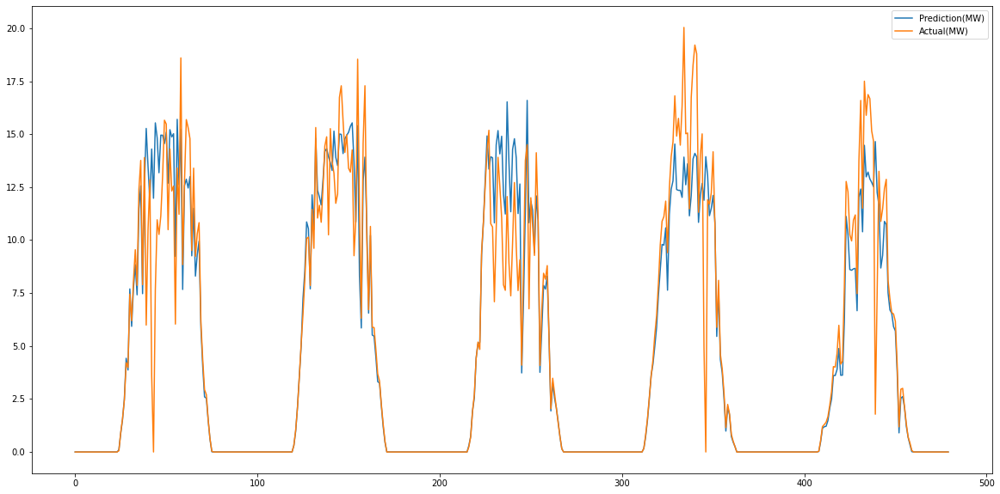

In [ ]:
actual_vs_pred.plot(figsize = (20,10))

In [ ]:
# For states such as Madhya Pradesh, Uttar Pradesh, Andhra Pradesh, Karnataka
act_df = df_test[['BLOCK','DATE','TIME','AC_POWER']]
def dsm_code_1(avc,df_pred,df_act):
    #Renaming columns
    df_act.columns = ['BLOCK','DATE','TIME','Actual Gen (MW)']
    df_pred.columns = ['Predicted Gen (MW)']
    
    df = pd.concat([df_act,df_pred],axis=1)
    # Modified Deviation
    df['Deviation %'] = (abs(df_act['Actual Gen (MW)'] - df_pred['Predicted Gen (MW)']))/avc*100
    dsm_list = []
    
    ##Converting MW into kWh(unit)
    avc_units = avc * 250
    
    
    for i in range(len(df)):
        #No. of units deviated
        units_dev = abs((df['Actual Gen (MW)'][i]-df['Predicted Gen (MW)'][i]))*250
        dev = df['Deviation %'][i]
        #1st Deviation band
        if dev <=15:
            dsm_list.append(0)
        #2nd Deviation band
        elif dev>15 and dev<=25:
            dsm1 = (units_dev - (0.15*avc_units)) * 0.5
            dsm_list.append(abs(dsm1))
        #3rd Deviation band
        elif dev>25 and dev<=35:
            dsm1 =  0.1* avc_units * 0.5
            dsm2 = (units_dev - (0.25*avc_units)) * 1
            dsm_list.append(abs(dsm1)+abs(dsm2))
        #4th Deviation band
        else:  
            dsm1 =  0.1 * avc_units * 0.5
            dsm2 =  0.1 * avc_units * 1
            dsm3 = (units_dev -(0.35*avc_units)) * 1.5
            dsm_list.append(abs(dsm1)+abs(dsm2)+abs(dsm3))
            
    #Concat DSM blockwise in dataframe
    abc = pd.concat([df,pd.Series(dsm_list)],axis=1)
    
    abc.columns=['BLOCK','DATE','TIME','Actual Gen (MW)','Predicted Gen (MW)','Deviation %','DSM (Rs.)'] 
    abc = abc[['DATE','TIME','BLOCK','Actual Gen (MW)','Predicted Gen (MW)','Deviation %','DSM (Rs.)']]
    
    print('MAPE : {}%'.format(round(abc['Deviation %'].mean(),2)))
    print('Total DSM: Rs.{}'.format(round(abc['DSM (Rs.)'].sum(),2)))      

    return abc

# For states such as Gujarat
def dsm_code_2(avc,df_pred,df_act):

    #Renaming columns
    df_act.columns = ['BLOCK','DATE','TIME','Actual Gen (MW)']
    df_pred.columns = ['Predicted Gen (MW)']
    df = pd.concat([df_act,df_pred],axis=1)
    
    # Modified Deviation
    df['Deviation %'] = (abs(df_act['Actual Gen (MW)'] - df_pred['Predicted Gen (MW)']))/avc*100
    
    dsm_list = []
    
    ##Converting MW into kWh(unit)
    avc_units = avc * 250
    
    for i in range(len(df)):
        #No. of units deviated
        units_dev = abs((df['Actual Gen (MW)'][i]-df['Predicted Gen (MW)'][i]))*250
        dev = df['Deviation %'][i]
        #1st Deviation band
        if dev <= 7:
            dsm_list.append(0)
        #2nd Deviation band
        elif dev>7 and dev<=15:
            dsm1 = (units_dev - (0.07*avc_units)) * 0.25
            dsm_list.append(abs(dsm1))
        #3rd Deviation band
        elif dev>15 and dev<=23:
            dsm1 =  0.08 * avc_units * 0.25
            dsm2 = (units_dev - (0.23*avc_units)) * 0.5
            dsm_list.append(abs(dsm1)+abs(dsm2))
        #4th Deviation band
        else:  
            dsm1 =  0.08 * avc_units * 0.25
            dsm2 =  0.08 * avc_units * 0.5
            dsm3 = (units_dev -(0.23*avc_units)) * 0.75
            dsm_list.append(abs(dsm1)+abs(dsm2)+abs(dsm3))
    
    #Concat DSM blockwise in dataframe
    abc = pd.concat([df,pd.Series(dsm_list)],axis=1)
    
    abc.columns=['BLOCK','DATE','TIME','Actual Gen (MW)','Predicted Gen (MW)','Deviation %','DSM (Rs.)'] 
    abc = abc[['DATE','TIME','BLOCK','Actual Gen (MW)','Predicted Gen (MW)','Deviation %','DSM (Rs.)']]
    
    print('MAPE : {}%'.format(round(abc['Deviation %'].mean(),2)))
    print('Total DSM: Rs.{}'.format(round(abc['DSM (Rs.)'].sum(),2)))      


    return abc 

In [ ]:
report1_day1 = dsm_code_1(25,y_pred_rf[0:96].reset_index(drop=True),act_df[0:96].reset_index(drop=True))
display(report1_day1[30:45])

MAPE : 4.06%
Total DSM: Rs.5696.05


,DATE,TIME,BLOCK,Actual Gen (MW),Predicted Gen (MW),Deviation %,DSM (Rs.)
30,2020-06-13,07:30,31,7.451572,7.696379,0.979225,0.000000
31,2020-06-13,07:45,32,6.195346,5.928818,1.066113,0.000000
32,2020-06-13,08:00,33,8.081417,7.738409,1.372032,0.000000
33,2020-06-13,08:15,34,9.546169,8.841000,2.820677,0.000000
34,2020-06-13,08:30,35,7.863040,7.418205,1.779341,0.000000
35,2020-06-13,08:45,36,12.399101,11.472707,3.705577,0.000000
36,2020-06-13,09:00,37,13.762022,12.560191,4.807327,0.000000
37,2020-06-13,09:15,38,7.896592,7.471824,1.699072,0.000000
38,2020-06-13,09:30,39,13.896894,12.551868,5.380105,0.000000
39,2020-06-13,09:45,40,5.990160,15.270808,37.122591,1136.492916
